In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas_profiling
from sklearn import linear_model
from sklearn import svm
from sklearn import naive_bayes
from sklearn import neighbors
from sklearn import tree
from sklearn import ensemble
from sklearn.decomposition import PCA
from sklearn import metrics
from sklearn.model_selection import train_test_split
pd.set_option('display.max_columns', 100)

In [2]:
df = pd.read_csv('data/FetalHealthClassification/fetal_health.csv', encoding='utf-8')
df

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,mean_value_of_long_term_variability,histogram_width,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.000,0.000,0.000,0.0,0.0,73.0,0.5,43.0,2.4,64.0,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.000,0.006,0.003,0.0,0.0,17.0,2.1,0.0,10.4,130.0,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.1,0.0,13.4,130.0,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.4,0.0,23.0,117.0,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.000,0.008,0.000,0.0,0.0,16.0,2.4,0.0,19.9,117.0,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2121,140.0,0.000,0.000,0.007,0.000,0.0,0.0,79.0,0.2,25.0,7.2,40.0,137.0,177.0,4.0,0.0,153.0,150.0,152.0,2.0,0.0,2.0
2122,140.0,0.001,0.000,0.007,0.000,0.0,0.0,78.0,0.4,22.0,7.1,66.0,103.0,169.0,6.0,0.0,152.0,148.0,151.0,3.0,1.0,2.0
2123,140.0,0.001,0.000,0.007,0.000,0.0,0.0,79.0,0.4,20.0,6.1,67.0,103.0,170.0,5.0,0.0,153.0,148.0,152.0,4.0,1.0,2.0
2124,140.0,0.001,0.000,0.006,0.000,0.0,0.0,78.0,0.4,27.0,7.0,66.0,103.0,169.0,6.0,0.0,152.0,147.0,151.0,4.0,1.0,2.0


In [3]:
df.profile_report(title='FetalHealthClassification - report')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
df.drop_duplicates(inplace=True)

In [5]:
df.dtypes

baseline value                                            float64
accelerations                                             float64
fetal_movement                                            float64
uterine_contractions                                      float64
light_decelerations                                       float64
severe_decelerations                                      float64
prolongued_decelerations                                  float64
abnormal_short_term_variability                           float64
mean_value_of_short_term_variability                      float64
percentage_of_time_with_abnormal_long_term_variability    float64
mean_value_of_long_term_variability                       float64
histogram_width                                           float64
histogram_min                                             float64
histogram_max                                             float64
histogram_number_of_peaks                                 float64
histogram_

In [7]:
df['fetal_health'] = df['fetal_health'].astype('int64')

In [9]:
X = df.drop('fetal_health', axis=1)
y = df['fetal_health']

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8)
print(X_train.shape)
print(X_test.shape)

(1690, 21)
(423, 21)


In [10]:
models = [linear_model.LogisticRegression(),
          neighbors.KNeighborsClassifier(),
          svm.SVC(),
          naive_bayes.GaussianNB(),
          tree.DecisionTreeClassifier(max_depth=3),
          ensemble.RandomForestClassifier(max_depth=3),
          ensemble.GradientBoostingClassifier()]

In [12]:
df_model_comp = pd.DataFrame()
for model in models:
    dic = dict()
    print(model.__class__.__name__)
    dic['モデル名'] = model.__class__.__name__
    model.fit(X_train,y_train)
    y_pred = model.predict(X_train)
    dic['Accuracy(訓練)'] = metrics.accuracy_score(y_train, y_pred)
    dic['Precision(訓練)'] = metrics.precision_score(y_train, y_pred, average='micro')
    dic['Recall(訓練)'] = metrics.recall_score(y_train, y_pred, average='micro')
    dic['F1(訓練)'] = metrics.f1_score(y_train, y_pred, average='micro')
    y_pred = model.predict(X_test)
    dic['Accuracy(テスト)'] = metrics.accuracy_score(y_test, y_pred)
    dic['Precision(テスト)'] = metrics.precision_score(y_test, y_pred, average='micro')
    dic['Recall(テスト)'] = metrics.recall_score(y_test, y_pred, average='micro')
    dic['F1(テスト)'] = metrics.f1_score(y_test, y_pred, average='micro')
    df_model_comp = df_model_comp.append(dic,ignore_index=True)
df_model_comp

LogisticRegression
KNeighborsClassifier


C:\Users\ishih\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


SVC
GaussianNB
DecisionTreeClassifier
RandomForestClassifier
GradientBoostingClassifier


,モデル名,Accuracy(訓練),Precision(訓練),Recall(訓練),F1(訓練),Accuracy(テスト),Precision(テスト),Recall(テスト),F1(テスト)
0,LogisticRegression,0.859763,0.859763,0.859763,0.859763,0.881797,0.881797,0.881797,0.881797
1,KNeighborsClassifier,0.925444,0.925444,0.925444,0.925444,0.910165,0.910165,0.910165,0.910165
2,SVC,0.855621,0.855621,0.855621,0.855621,0.881797,0.881797,0.881797,0.881797
3,GaussianNB,0.812426,0.812426,0.812426,0.812426,0.829787,0.829787,0.829787,0.829787
4,DecisionTreeClassifier,0.905917,0.905917,0.905917,0.905917,0.907801,0.907801,0.907801,0.907801
5,RandomForestClassifier,0.909467,0.909467,0.909467,0.909467,0.900709,0.900709,0.900709,0.900709
6,GradientBoostingClassifier,0.995266,0.995266,0.995266,0.995266,0.955083,0.955083,0.955083,0.955083


In [13]:
from sklearn.preprocessing import StandardScaler

scaling_columns = X_train.dtypes[X_train.dtypes != 'uint8'].index
scaler = StandardScaler().fit(X_train[scaling_columns])

scaled_train = pd.DataFrame(scaler.transform(X_train[scaling_columns]), columns=scaling_columns, index=X_train.index)
X_train.update(scaled_train)

scaled_test = pd.DataFrame(scaler.transform(X_test[scaling_columns]), columns=scaling_columns, index=X_test.index)
X_test.update(scaled_test)

In [14]:
df_model_comp = pd.DataFrame()
for model in models:
    dic = dict()
    print(model.__class__.__name__)
    dic['モデル名'] = model.__class__.__name__
    model.fit(X_train,y_train)
    y_pred = model.predict(X_train)
    dic['Accuracy(訓練)'] = metrics.accuracy_score(y_train, y_pred)
    dic['Precision(訓練)'] = metrics.precision_score(y_train, y_pred, average='micro')
    dic['Recall(訓練)'] = metrics.recall_score(y_train, y_pred, average='micro')
    dic['F1(訓練)'] = metrics.f1_score(y_train, y_pred, average='micro')
    y_pred = model.predict(X_test)
    dic['Accuracy(テスト)'] = metrics.accuracy_score(y_test, y_pred)
    dic['Precision(テスト)'] = metrics.precision_score(y_test, y_pred, average='micro')
    dic['Recall(テスト)'] = metrics.recall_score(y_test, y_pred, average='micro')
    dic['F1(テスト)'] = metrics.f1_score(y_test, y_pred, average='micro')
    df_model_comp = df_model_comp.append(dic,ignore_index=True)
df_model_comp

LogisticRegression
KNeighborsClassifier
SVC
GaussianNB
DecisionTreeClassifier
RandomForestClassifier
GradientBoostingClassifier


,モデル名,Accuracy(訓練),Precision(訓練),Recall(訓練),F1(訓練),Accuracy(テスト),Precision(テスト),Recall(テスト),F1(テスト)
0,LogisticRegression,0.907692,0.907692,0.907692,0.907692,0.905437,0.905437,0.905437,0.905437
1,KNeighborsClassifier,0.939053,0.939053,0.939053,0.939053,0.888889,0.888889,0.888889,0.888889
2,SVC,0.934911,0.934911,0.934911,0.934911,0.917258,0.917258,0.917258,0.917258
3,GaussianNB,0.726036,0.726036,0.726036,0.726036,0.716312,0.716312,0.716312,0.716312
4,DecisionTreeClassifier,0.905917,0.905917,0.905917,0.905917,0.907801,0.907801,0.907801,0.907801
5,RandomForestClassifier,0.905325,0.905325,0.905325,0.905325,0.898345,0.898345,0.898345,0.898345
6,GradientBoostingClassifier,0.995266,0.995266,0.995266,0.995266,0.955083,0.955083,0.955083,0.955083


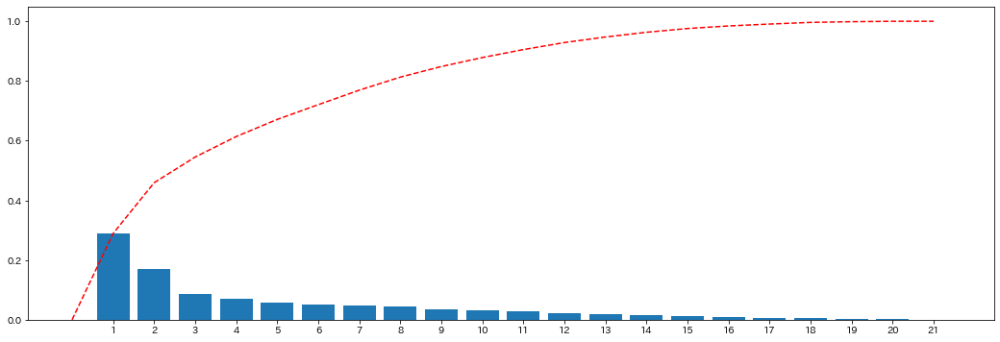

In [15]:
plt.figure(figsize=(18,6))
pca = PCA()
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)
plt.bar([n for n in range(1, len(pca.explained_variance_ratio_)+1)], pca.explained_variance_ratio_)
ev_ratio = pca.explained_variance_ratio_
ev_ratio = np.hstack([0,ev_ratio.cumsum()])
plt.plot(ev_ratio, color='red', linestyle='dashed')
plt.xticks(range(1, X_train.shape[-1]+1))
plt.show()

In [16]:
n = 8
columns=[f'PC{i+1}' for i in range(n)]
X_train_pca = pd.DataFrame(X_train_pca[:,:n], columns=columns)
X_test_pca = pd.DataFrame(X_test_pca[:,:n], columns=columns)

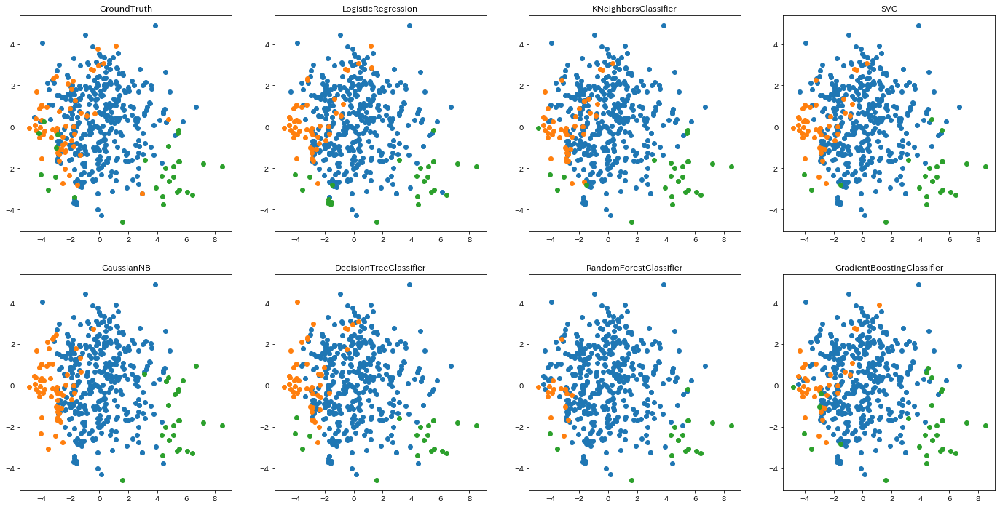

,モデル名,Accuracy(訓練),Precision(訓練),Recall(訓練),F1(訓練),Accuracy(テスト),Precision(テスト),Recall(テスト),F1(テスト)
0,LogisticRegression,0.891124,0.891124,0.891124,0.891124,0.895981,0.895981,0.895981,0.895981
1,KNeighborsClassifier,0.933728,0.933728,0.933728,0.933728,0.893617,0.893617,0.893617,0.893617
2,SVC,0.911243,0.911243,0.911243,0.911243,0.905437,0.905437,0.905437,0.905437
3,GaussianNB,0.860355,0.860355,0.860355,0.860355,0.867612,0.867612,0.867612,0.867612
4,DecisionTreeClassifier,0.867456,0.867456,0.867456,0.867456,0.877069,0.877069,0.877069,0.877069
5,RandomForestClassifier,0.863314,0.863314,0.863314,0.863314,0.851064,0.851064,0.851064,0.851064
6,GradientBoostingClassifier,0.978698,0.978698,0.978698,0.978698,0.907801,0.907801,0.907801,0.907801


In [17]:
df_model_comp = pd.DataFrame()

fig, ax = plt.subplots(ncols=4, nrows=2, figsize=(24.0,12.0))
ax = ax.flatten()
for j in np.unique(y_test):
    X_tmp = X_test_pca[y_test.values == j]
    ax[0].scatter(X_tmp['PC1'], X_tmp['PC2'], label=j)
ax[0].set_title('GroundTruth')

for i, model in enumerate(models):
    dic = dict()
    dic['モデル名'] = model.__class__.__name__
    model.fit(X_train_pca,y_train)
    y_pred = model.predict(X_train_pca)
    dic['Accuracy(訓練)'] = metrics.accuracy_score(y_train, y_pred)
    dic['Precision(訓練)'] = metrics.precision_score(y_train, y_pred, average='micro')
    dic['Recall(訓練)'] = metrics.recall_score(y_train, y_pred, average='micro')
    dic['F1(訓練)'] = metrics.f1_score(y_train, y_pred, average='micro')
    y_pred = model.predict(X_test_pca)
    dic['Accuracy(テスト)'] = metrics.accuracy_score(y_test, y_pred)
    dic['Precision(テスト)'] = metrics.precision_score(y_test, y_pred, average='micro')
    dic['Recall(テスト)'] = metrics.recall_score(y_test, y_pred, average='micro')
    dic['F1(テスト)'] = metrics.f1_score(y_test, y_pred, average='micro')
    df_model_comp = df_model_comp.append(dic,ignore_index=True)
    for j in np.unique(y_pred):
        X_tmp = X_test_pca[y_pred == j]
        ax[i+1].scatter(X_tmp['PC1'], X_tmp['PC2'], label=j)
    ax[i+1].set_title(model.__class__.__name__)
plt.show()

df_model_comp